In [1]:
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

In [2]:
# Set random seed for reproducibility
manualSeed = 999
#manualSeed = random.randint(1, 10000) # use if you want new results
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)
torch.use_deterministic_algorithms(True) # Needed for reproducible results

Random Seed:  999


asdasda

In [3]:
img_folder = 'celebA/'
img_size = 64

In [4]:
dataset = dset.ImageFolder(root=img_folder,
                           transform=transforms.Compose([
                               transforms.Resize(img_size),
                               transforms.CenterCrop(img_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)), # Esta vez normalizamos los 3 canales
                           ]))

In [5]:
# Create the dataloader
dataloader = torch.utils.data.DataLoader(dataset, batch_size=128,
                                         shuffle=True, num_workers=2)

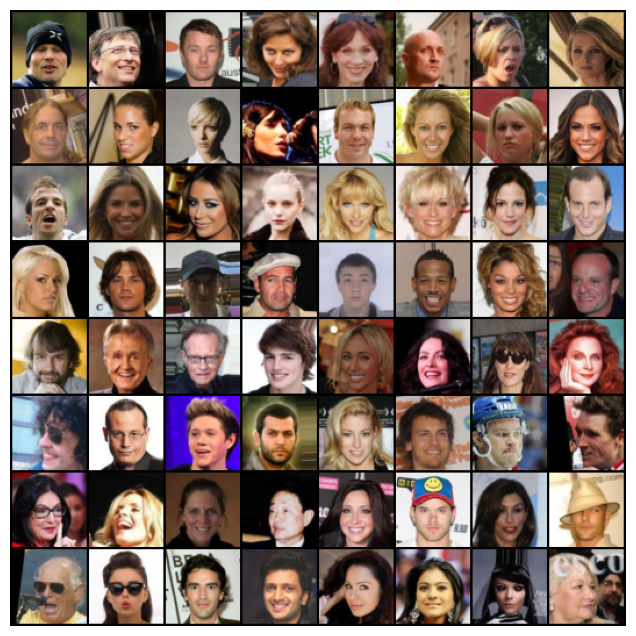

In [6]:
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis(False)
plt.imshow(np.transpose(vutils.make_grid(real_batch[0][:64], padding=2, normalize=True),(1,2,0)))

De acuerdo al paper: "_All weights were initialized from a zero-centered Normal distribution
with standard deviation 0.02._"

Creamos una función que inicializa los parámetros de la red con esos valores para luego aplicarla selectivamente a las capas que correspondan.

In [7]:
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

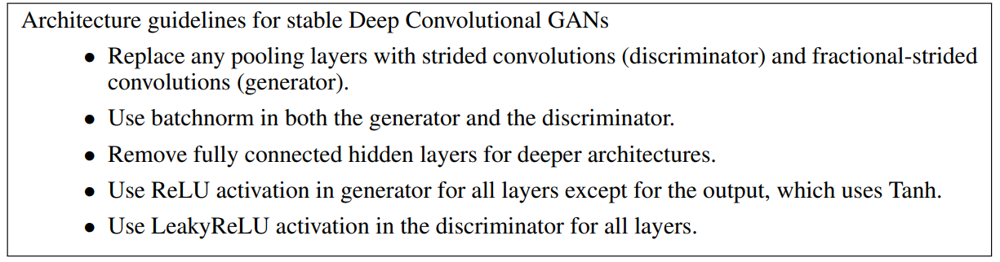

## Generador
Esta es la arquitectura propuesta, la cual replicaremos utilizando la mitad de los canales en cada feature map.
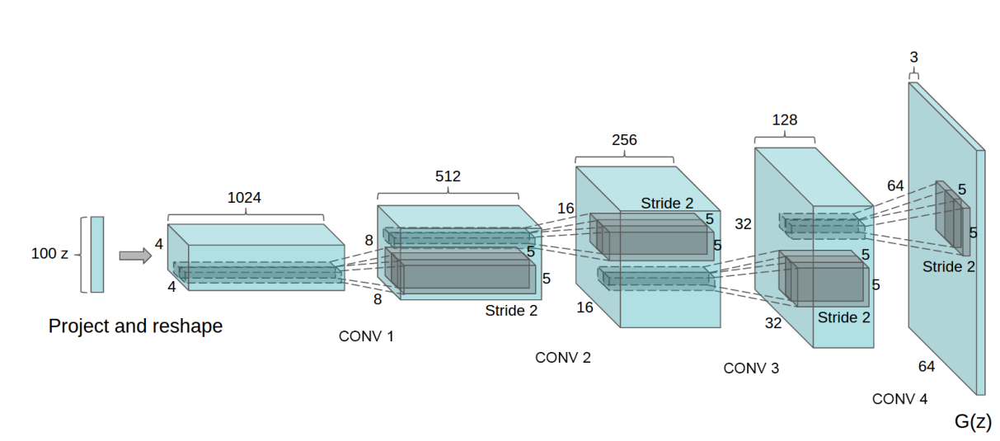
Nosotros usaremos 512 -> 256 -> 128 -> 64 -> 3 (RGB)

In [8]:
Z_DIM = 100

In [9]:
class Generator(nn.Module):
    def __init__(self):
        super().__init__()
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d(
                in_channels=Z_DIM, 
                out_channels=512, 
                kernel_size=4, 
                stride=1, 
                padding=0, 
                bias=False
            ),
            nn.BatchNorm2d(512),
            nn.ReLU(True),
            # Feature map de 512 x 4 x 4
            nn.ConvTranspose2d(
                in_channels=512,
                out_channels=256,
                kernel_size=4, 
                stride=2, 
                padding=1, 
                bias=False),
            nn.BatchNorm2d(256),
            nn.ReLU(True),
            # Feature map de 256 x 8 x 8
            nn.ConvTranspose2d(
                in_channels=256, 
                out_channels=128, 
                kernel_size=4, 
                stride=2,
                padding=1, 
                bias=False),
            nn.BatchNorm2d(128),
            nn.ReLU(True),
            # Feature map de 128 x 16 x 16
            nn.ConvTranspose2d(
                in_channels=128, 
                out_channels=64,
                kernel_size=4,
                stride=2,
                padding=1, 
                bias=False),
            nn.BatchNorm2d(64),
            nn.ReLU(True),
            # Feature map de 64 x 32 x 32``
            nn.ConvTranspose2d(
                in_channels=64, 
                out_channels=3,
                kernel_size=4,
                stride=2,
                padding=1, 
                bias=False),
            nn.Tanh()
            # Salida de 3x64x64 con valores en el rango (-1,1)
        )

    def forward(self, input):
        return self.main(input)

Instanciamos una red generadora y le aplicamos la función de inicialización que declaramos antes y procesamos datos random para testear el funcionamiento

In [10]:
G = Generator()
G.apply(weights_init)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)

In [11]:
z = torch.randn(
    1, # Una sola muestra
    Z_DIM, 1, 1 # de tamaño (100x1x1)
)
with torch.no_grad():
    fake_img = G(z)
fake_img.shape

torch.Size([1, 3, 64, 64])

Si ploteamos la imágen generada, debería ser puro ruido

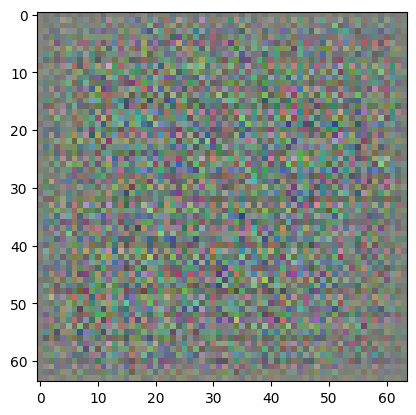

In [12]:
fake_img_post = (fake_img + 1) / 2 # llevamos los valores del rango (-1, 1) al rango (0, 1)
plt.imshow(fake_img_post[0].permute(1, 2, 0).detach().numpy())

## Dsicriminador

Crearemos un discriminador convolucional con una arquitectura similar a la del generador pero en sentido inverso (usando convoluciones en lugar de convoluciones traspuestas) para generar un feature map de 1x1x1, es decir un único valor, al que le aplicaremos una función sigmode para producir una salida en el rango (0, 1)

In [13]:
class Discriminator(nn.Module):
    def __init__(self):
        super().__init__()
        self.main = nn.Sequential(
            # La entrada será una imágen de 3 canales de 64x64
            nn.Conv2d(
                in_channels=3,
                out_channels=64,
                kernel_size=4,
                stride=2,
                padding=1,
                bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``64 x 32 x 32``
            nn.Conv2d(
                in_channels=64,
                out_channels=128,
                kernel_size=4,
                stride=2,
                padding=1, 
                bias=False),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``128 x 16 x 16``
            nn.Conv2d(
                in_channels=128,
                out_channels=256,
                kernel_size=4,
                stride=2, 
                padding=1, 
                bias=False),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``256 x 8 x 8``
            nn.Conv2d(
                in_channels=256,
                out_channels=512,
                kernel_size=4,
                stride=2,
                padding=1, 
                bias=False),
            nn.BatchNorm2d(512),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``512 x 4 x 4``
            nn.Conv2d(
                in_channels=512, 
                out_channels=1, 
                kernel_size=4, # al aplicar un kernel de 4x4 a un feature map de 4x4 se obtiene una salida de 1x1
                stride=1, 
                padding=0, 
                bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

Instanciamos una red discriminadora y le aplicamos la función de inicialización que declaramos antes y procesamos la imágen que generamos para ver si hay algún error. La salida debería ser un único valor entre 0 y 1.

In [14]:
D = Discriminator()
D.apply(weights_init)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)

In [15]:
with torch.no_grad():
    output = D(fake_img)
output.shape

torch.Size([1, 1, 1, 1])

In [16]:
output

tensor([[[[0.4898]]]])

## Entrenamiento

Usaremos un loop de entrenamiento similar al de la otra notebook, generando imágenes a partir de una muestra de ruido (siempre la misma, para poder comparar la evolución de las imágenes generadas).

Usaremos los valores propuestos en el paper para los parámetros de los optimizadores ya que hacen que el proceso sea más estable.

In [17]:
loss_fn = nn.BCELoss()

In [18]:
DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
NUM_EPOCHS = 5
LEARNING_RATE = 2e-4
BETA_1 = 0.5


In [19]:
D = D.to(DEVICE)
G = G.to(DEVICE)
loss_fn = loss_fn.to(DEVICE)


optimizerD = optim.Adam(D.parameters(), lr=LEARNING_RATE, betas=(BETA_1, 0.999))
optimizerG = optim.Adam(G.parameters(), lr=LEARNING_RATE, betas=(BETA_1, 0.999))

In [20]:
from tqdm import tqdm

In [21]:
def train(D, G, z_dim, loss_fn, opt_D, opt_G, dataloader, num_epochs, device, save_every_n_iters=250):

    G = G.to(device)
    D = D.to(device)
    loss_fn = loss_fn.to(device)
    N_samples = 10
    fixed_noise = torch.randn(64, z_dim, 1, 1, device=device)
    
    losses_D = []
    losses_G = []
    img_list = []
    
    iters=0
    # Comenzamos el loop de entrenamiento
    for epoch in range(num_epochs):
        progress = tqdm(dataloader)
        progress.set_description(desc=f"Epoch {epoch+1}")
    
        batch_loss_D = []
        batch_loss_G = []
        
        for i, (real_img, _) in enumerate(progress): # Tomamos una muestra del dataloader, descartando las etiquetas que no son necesarias
    
            ### DISCRIMINADOR ###
            
            real_img = real_img.to(device) # Aplanamos las imágenes
            
            # Debemos estar seguros del tamaño del batch, ya que el tamaño del dataset puede no ser divisible por BATCH_SIZE
            batch_size = real_img.shape[0]
    
            # Tomamos una muestra de m vectores de dimensión z_dim, donde m es el tamaño (real) del batch
            z = torch.randn(batch_size, z_dim, 1, 1, device=device)
    
            # Generamos imágenes falsas usando los vectores muestreados
            fake_img = G(z)
    
            # Calculamos la salida del discriminador para las imágenes reales
            disc_real = D(real_img) # Deben ser valores cercanos a 1
    
            # Calculamos la salida del discriminador para las imágenes falsas
            disc_fake = D(fake_img) # Deben ser valores cercanos a 0
    
            # Calculamos el primer término de la función de pérdida del discriminador, que corresponde a las imágenes reales
            lossD_real = loss_fn(disc_real, torch.ones_like(disc_real)) 
            # Calculamos el primer término de la función de pérdida del discriminador, que corresponde a las imágenes falsas
            lossD_fake = loss_fn(disc_fake, torch.zeros_like(disc_fake))
            # Componemos la pérdida del discriminador
            lossD = lossD_real + lossD_fake
            # Reseteamos y calculamos gradientes y actualizamos los parámetros de la red
            D.zero_grad()
            lossD.backward()
            opt_D.step()
    
            ### GENERADOR ###
            # Tomamos una muestra de m vectores de dimensión z_dim, donde m es el tamaño (real) del batch
            z = torch.randn(batch_size, z_dim, 1, 1, device=device)
            
            # Generamos imágenes falsas a partir de la muestra
            fake_img = G(z)
            # Las procesamos con el discriminador
            disc_fake = D(fake_img)
            # Como estamos entrenando el generador, el objetivo es lograr que el discriminador crea que son reales (output=1)
            lossG = loss_fn(disc_fake, torch.ones_like(disc_fake))
            # Reseteamos y calculamos gradientes y actualizamos los parámetros de la red
            G.zero_grad()
            lossG.backward()
            opt_G.step()
    
            progress.set_postfix({'lossD': lossD.item(), 'lossG': lossG.item()})
    
            batch_loss_D.append(lossD.item())
            batch_loss_G.append(lossG.item())

            # Check how the generator is doing by saving G's output on fixed_noise
            if save_every_n_iters and ((iters % save_every_n_iters == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1))):
                with torch.no_grad():
                    fake = G(fixed_noise).detach().cpu()
                img_list.append(vutils.make_grid(fake, padding=2, normalize=True))
    
            iters += 1
        
        losses_D.extend(batch_loss_D)
        losses_G.extend(batch_loss_G)
        batch_loss_D = sum(batch_loss_D) / len(batch_loss_D)
        batch_loss_G = sum(batch_loss_G) / len(batch_loss_G)
        progress.set_postfix({'lossD': batch_loss_D, 'lossG': batch_loss_G})


           
    return losses_D, losses_G, img_list

In [25]:
losses_D, losses_G, img_list = train(D, G, Z_DIM, loss_fn, optimizerD, optimizerG, dataloader, num_epochs=5, device=DEVICE)

Epoch 5: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1583/1583 [04:27<00:00,  5.91it/s, lossD=0.592, lossG=2.47]


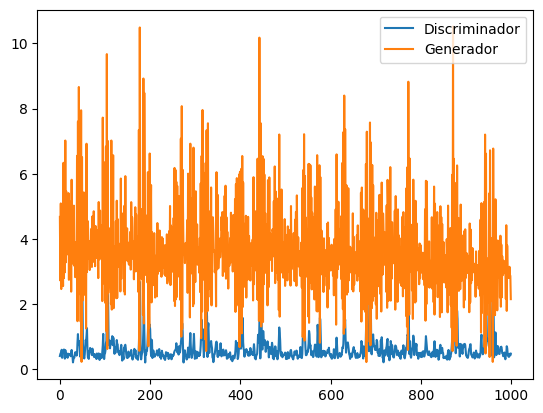

In [28]:
plt.plot(losses_D[:1000])
plt.plot(losses_G[:1000])
plt.legend(['Discriminador', 'Generador'])

In [30]:
len(img_list)

33

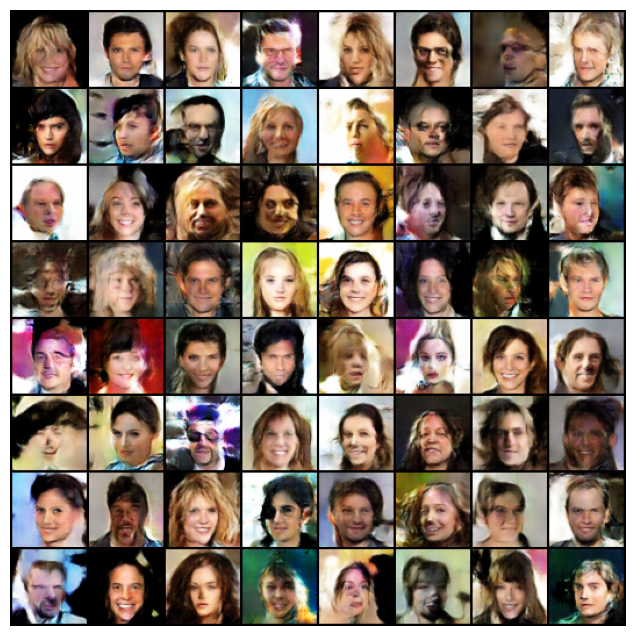

In [31]:
fig = plt.figure(figsize=(8,8));
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list[:15]];
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

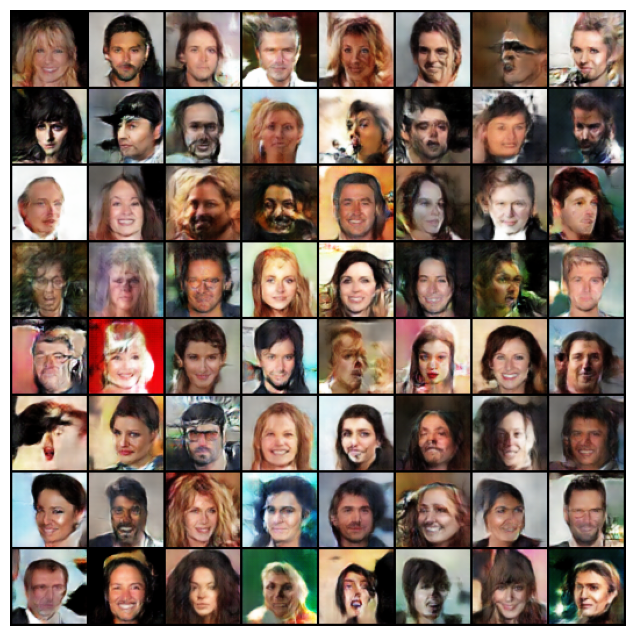

In [32]:
fig = plt.figure(figsize=(8,8));
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list[15:]];
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

In [33]:
if 0:
    print("asd")